<a href="https://colab.research.google.com/github/ivaben/DS-Unit-2-Applied-Modeling/blob/master/IVANA_B_assignment_4_Applied_modeling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Lambda School Data Science

Unit 2, Sprint 3, Module 4

# Model Interpretation

You will use your portfolio project dataset for all assignments this sprint.

# Assignment

Complete these tasks for your project, and document your work.



 

 

 


1.   Continue to iterate on your project: data cleaning, exploratory visualization, feature engineering, modeling.
2.   Make at least 1 partial dependence plot to explain your model.

3.  Make at least 1 Shapley force plot to explain an individual prediction.  
4.  Share at least 1 visualization (of any type) on Slack!

If you aren't ready to make these plots with your own dataset, you can practice these objectives with any dataset you've worked with previously. Example solutions are available for Partial Dependence Plots with the Tanzania Waterpumps dataset, and Shapley force plots with the Titanic dataset. (These datasets are available in the data directory of this repository.)

Please be aware that multi-class classification will result in multiple Partial Dependence Plots (one for each class), and multiple sets of Shapley Values (one for each class).




# **Stretch Goals**

**Partial Dependence Plots**



*   Make multiple PDPs with 1 feature in isolation.
*    Make multiple PDPs with 2 features in interaction.
*  Use Plotly to make a 3D PDP.
* Make PDPs with categorical feature(s). Use Ordinal Encoder, outside of a pipeline, to encode your data first. If there is a natural ordering, then take the time to encode it that way, instead of random integers. Then use the encoded data with pdpbox. Get readable category names on your plot, instead of integer category codes.



**Shap** **Values**



*    Make Shapley force plots to explain at least 4 individual predictions.

If your project is Binary Classification, you can do a True Positive, True Negative, False Positive, False Negative.

If your project is Regression, you can do a high prediction with low error, a low prediction with low error, a high prediction with high error, and a low prediction with high error.
*   Use Shapley values to display verbal explanations of individual predictions.
*  Use the SHAP library for other visualization types.



The SHAP repo has examples for many visualization types, including:

Force Plot, individual predictions

Force Plot, multiple predictions
Dependence Plot

Summary Plot

Summary Plot, Bar

Interaction Values

Decision Plots

We just did the first type during the lesson. The Kaggle microcourse shows two more. Experiment and see what you can learn!




In [252]:
!pip install category_encoders==2.*
!pip install pandas-profiling==2.*
!pip install category_encoders==2.*
!pip install eli5
!pip install pdpbox
!pip install shap


     |████████████████████████████████| 57.7MB 70kB/s 
  Created wheel for pdpbox: filename=PDPbox-0.2.0-cp36-none-any.whl size=57690723 sha256=11264e9f4b44007debcbcc4c4231364e4d938121b63f64e27aeaa881b8c8e1f5
  Stored in directory: /root/.cache/pip/wheels/7d/08/51/63fd122b04a2c87d780464eeffb94867c75bd96a64d500a3fe
Successfully built pdpbox
     |████████████████████████████████| 266kB 8.9MB/s 
  Created wheel for shap: filename=shap-0.33.0-cp36-cp36m-linux_x86_64.whl size=382260 sha256=b4a4ab021332f98beebe2cf60a270aca51bcdd28a611bce3fd076f03d802caea
  Stored in directory: /root/.cache/pip/wheels/39/0f/88/a8124d43431284e10f263ffe449e119344c6145c3a165d186c
Successfully built shap


In [0]:

import warnings
warnings.filterwarnings(action='ignore', category=FutureWarning, module='numpy')

In [0]:
# Read NHL  data

import pandas as pd
import numpy as np


url = 'https://raw.githubusercontent.com/ivaben/unit-2-project/master/train.csv'

df = pd.read_csv (url, encoding='iso-8859-1')


In [318]:
df.head()

,Salary,Born,City,Pr/St,Cntry,Nat,Ht,Wt,DftYr,DftRd,Ovrl,Hand,Last Name,First Name,Position,Team,GP,G,A,A1,A2,PTS,+/-,E+/-,PIM,Shifts,TOI,TOIX,TOI/GP,TOI/GP.1,TOI%,IPP%,SH%,SV%,PDO,F/60,A/60,Pct%,Diff,Diff/60,...,Min,Maj,Match,Misc,Game,CF,CA,FF,FA,SF,SA,xGF,xGA,SCF,SCA,GF,GA,RBF,RBA,RSF,RSA,DSF,DSA,FOW,FOL,HF,HA,GVA,TKA,PENT,PEND,OPS,DPS,PS,OTOI,Grit,DAP,Pace,GS,GS/G
0,925000,97-01-30,Sainte-Marie,QC,CAN,CAN,74,190,"2,015",1,18,L,Chabot,Thomas,D,OTT,1,0,0,0,0,0,-2,0,0,13,429,7,7,7,15,0,0,1,750,0,17,0,-2,-17,...,0,0,0,0,0,9,12,8,10,5,8,0,1,2,3,0,2,1,1,0,1,1,2,4,5,1,2,1,1,1,1,0,-0,-0,40,1,0,176,-0,-0
1,2250000,93-12-21,Ottawa,ON,CAN,CAN,74,207,"2,012",1,15,R,Ceci,Cody,D,OTT,79,2,15,6,9,17,-11,-10,20,2418,109992,"1,826",23,23,39,30,7,1,989,2,3,40,-29,-1,...,10,0,0,0,0,"1,433","1,992","1,038","1,423",757,997,62,89,197,280,56,85,68,82,79,94,147,176,949,939,749,671,284,197,104,98,-0,3,3,"2,851",290,13,112,14,0
2,8000000,88-04-16,St. Paul,MN,USA,USA,72,218,"2,006",1,7,R,Okposo,Kyle,RW,BUF,65,19,26,13,13,45,-7,-1,24,1443,73983,"1,229",19,19,33,63,10,1,"1,031",3,2,64,31,2,...,12,0,0,0,0,"1,301","1,051",986,826,734,606,71,46,235,133,71,40,60,34,76,52,136,86,739,600,340,351,168,129,56,70,4,1,5,"2,487",102,7,115,37,1
3,3500000,92-01-07,Ottawa,ON,CAN,CAN,77,220,"2,010",1,3,R,Gudbranson,Erik,D,VAN,30,1,5,5,0,6,-14,-5,18,765,36603,608,20,20,36,38,6,1,959,2,3,31,-19,-2,...,4,2,0,0,0,460,605,339,467,259,340,22,34,80,130,16,35,27,20,29,32,56,52,324,328,198,197,86,59,26,22,0,0,0,"1,074",130,18,105,6,0
4,1750000,94-03-29,Toronto,ON,CAN,CAN,76,217,"2,012",1,16,R,Wilson,Tom,RW,WSH,82,7,12,4,8,19,9,4,133,1453,63592,"1,060",13,13,24,61,8,1,995,2,2,43,-10,-1,...,33,9,0,1,1,766,992,546,720,398,495,34,48,124,159,31,41,30,37,43,53,73,90,528,490,512,422,157,126,88,68,-0,1,1,"3,459",425,8,100,22,0


In [0]:
# Drop columns
columns = {'City', 'Pr/St', 'Cntry', 'Ht', 'Wt', '+/-',	'E+/-',	'PIM',	'Shifts', 'DftRd', 'Ovrl', 'First Name', 'FOW.Down', 'FOL.Down',
                               'FOW.Close', 'FOL.Close','G.Bkhd', 'G.Dflct', 'G.Slap', 'G.Snap', 'G.Tip', 'G.Wrap',
                                'G.Wrst', 'dzFOW', 'dzFOL', 'nzFOW', 'nzFOL','RSA', 'RSF', 'S.Bkhd', 'S.Dflct',
                               'S.Slap', 'S.Snap', 'S.Tip', 'S.Wrap', 'S.Wrst', 'FF',	'FA', 'iPenT', 'iPenD', 'iFOW.1',
                               'iFOL.1',
                               'iPENT', 'iPEND', 'iPenDf', 'NPD', 'Min',	'Maj',	'Match',	'Misc', 'Game', 'iHF.1', 'iGVA.1', 'iTKA.1', 'iBLK.1', 'BLK%',	}
df = df.drop(df[columns], axis = 1)

In [320]:
df.shape

(612, 98)

Your code starts here:

In [0]:
# Change column names: replace spaces with underscores

In [321]:
df.rename(columns={'Last Name':'Last_name','Nat':'Nationality', 'GP':'Games_played',
                   'G':'Goals','PTS':'Points','PIM':'Penalty_minutes', 'A':'Events_against_per_60_minutes', 
                   'A1':'Primary_assists', 'A2':'Secondary_Assists', 'TOI':'Time_on_ice', 
                   'IPP%':'Indiv_points' }, inplace=True)
df.head()

,Salary,Born,Nationality,DftYr,Hand,Last_name,Position,Team,Games_played,Goals,Events_against_per_60_minutes,Primary_assists,Secondary_Assists,Points,Time_on_ice,TOIX,TOI/GP,TOI/GP.1,TOI%,Indiv_points,SH%,SV%,PDO,F/60,A/60,Pct%,Diff,Diff/60,iCF,iCF.1,iFF,iSF,iSF.1,iSF.2,ixG,iSCF,iRB,iRS,iDS,sDist,...,1G,GWG,ENG,PSG,PSA,CBar,Post,Over,Wide,CF,CA,SF,SA,xGF,xGA,SCF,SCA,GF,GA,RBF,RBA,DSF,DSA,FOW,FOL,HF,HA,GVA,TKA,PENT,PEND,OPS,DPS,PS,OTOI,Grit,DAP,Pace,GS,GS/G
0,925000,97-01-30,CAN,"2,015",L,Chabot,D,OTT,1,0,0,0,0,0,429,7,7,7,15,0,0,1,750,0,17,0,-2,-17,2,2,2,1,1,1,0,0,0,0,0,43,...,0,0,0,0,0,0,0,0,1,9,12,5,8,0,1,2,3,0,2,1,1,1,2,4,5,1,2,1,1,1,1,0,-0,-0,40,1,0,176,-0,-0
1,2250000,93-12-21,CAN,"2,012",R,Ceci,D,OTT,79,2,15,6,9,17,109992,"1,826",23,23,39,30,7,1,989,2,3,40,-29,-1,287,287,197,143,143,143,6,7,7,9,16,52,...,0,0,0,0,0,0,1,2,51,"1,433","1,992",757,997,62,89,197,280,56,85,68,82,147,176,949,939,749,671,284,197,104,98,-0,3,3,"2,851",290,13,112,14,0
2,8000000,88-04-16,USA,"2,006",R,Okposo,RW,BUF,65,19,26,13,13,45,73983,"1,229",19,19,33,63,10,1,"1,031",3,2,64,31,2,283,283,212,155,156,156,17,64,16,20,36,28,...,5,2,0,0,0,0,2,4,51,"1,301","1,051",734,606,71,46,235,133,71,40,60,34,136,86,739,600,340,351,168,129,56,70,4,1,5,"2,487",102,7,115,37,1
3,3500000,92-01-07,CAN,"2,010",R,Gudbranson,D,VAN,30,1,5,5,0,6,36603,608,20,20,36,38,6,1,959,2,3,31,-19,-2,88,88,55,40,40,40,1,2,1,4,5,55,...,0,1,0,0,0,0,0,0,15,460,605,259,340,22,34,80,130,16,35,27,20,56,52,324,328,198,197,86,59,26,22,0,0,0,"1,074",130,18,105,6,0
4,1750000,94-03-29,CAN,"2,012",R,Wilson,RW,WSH,82,7,12,4,8,19,63592,"1,060",13,13,24,61,8,1,995,2,2,43,-10,-1,166,166,118,95,95,95,9,35,8,10,18,31,...,2,0,1,0,0,0,2,1,20,766,992,398,495,34,48,124,159,31,41,30,37,73,90,528,490,512,422,157,126,88,68,-0,1,1,"3,459",425,8,100,22,0


In [322]:
df.columns

Index(['Salary', 'Born', 'Nationality', 'DftYr', 'Hand', 'Last_name',
       'Position', 'Team', 'Games_played', 'Goals',
       'Events_against_per_60_minutes', 'Primary_assists', 'Secondary_Assists',
       'Points', 'Time_on_ice', 'TOIX', 'TOI/GP', 'TOI/GP.1', 'TOI%',
       'Indiv_points', 'SH%', 'SV%', 'PDO', 'F/60', 'A/60', 'Pct%', 'Diff',
       'Diff/60', 'iCF', 'iCF.1', 'iFF', 'iSF', 'iSF.1', 'iSF.2', 'ixG',
       'iSCF', 'iRB', 'iRS', 'iDS', 'sDist', 'sDist.1', 'Pass', 'iHF', 'iHA',
       'iHDf', 'iMiss', 'iGVA', 'iTKA', 'iBLK', 'iFOW', 'iFOL', 'FO%', '%FOT',
       'ozFOW', 'ozFOL', 'FOW.Up', 'FOL.Up', 'OTG', '1G', 'GWG', 'ENG', 'PSG',
       'PSA', 'CBar ', 'Post', 'Over', 'Wide', 'CF', 'CA', 'SF', 'SA', 'xGF',
       'xGA', 'SCF', 'SCA', 'GF', 'GA', 'RBF', 'RBA', 'DSF', 'DSA', 'FOW',
       'FOL', 'HF', 'HA', 'GVA', 'TKA', 'PENT', 'PEND', 'OPS', 'DPS', 'PS',
       'OTOI', 'Grit', 'DAP', 'Pace', 'GS', 'GS/G'],
      dtype='object')

In [323]:
# Get Pandas Profiling Report
import pandas_profiling

profile_report = df.profile_report(
    check_correlation_pearson=False,
    correlations={
        'pearson': False,
        'spearman': False,
        'kendall': False,
        'phi_k': False,
        'cramers': False,
        'recoded': False,
    },
    plot={'histogram': {'bayesian_blocks_bins': False}},
)

profile_report

In [324]:
# Look how many rows you have?
df.shape

(612, 98)

In [0]:
df.fillna(0,inplace=True)

In [326]:
# The Pandas Profiling Report showed that SALE_PRICE was read as strings
# Convert it to integers

df['Salary'].dtypes

dtype('int64')

In [327]:
# Q. What is the maximum Salary in this dataset?
pd.options.display.float_format = '{:,.0f}'.format
df['Salary'].describe()

count          612
mean     2,264,509
std      2,236,340
min        575,000
25%        742,500
50%        925,000
75%      3,500,000
max     13,800,000
Name: Salary, dtype: float64

In [328]:
# Look at the row with the max Salary
import numpy as np

print(df[df.Salary == df.Salary.max()]) 

       Salary      Born Nationality  DftYr Hand  ... Grit DAP Pace  GS  GS/G
103  13800000  88-11-19         USA  2,007    L  ...   75   5  114  89     1
496  13800000  88-04-29         CAN  2,006    L  ...  111   5  117  62     1

[2 rows x 98 columns]


In [329]:
# Get value counts of TOTAL_UNITS
# Q. How many property sales were for multiple units?

target = 'Salary'
df[target].value_counts(normalize=False)

925000     80
575000     39
600000     29
4000000    20
5000000    19
           ..
3275000     1
850000      1
620000      1
2825000     1
7500000     1
Name: Salary, Length: 138, dtype: int64

In [0]:
features = ['Born', 'Nationality', 'DftYr', 'Hand', 'Last_name',
       'Position', 'Team', 'Games_played', 'Goals',
       'Events_against_per_60_minutes', 'Primary_assists', 'Secondary_Assists',
       'Points', 'Time_on_ice', 'TOIX', 'TOI/GP', 'TOI/GP.1', 'TOI%',
       'Indiv_points', 'SH%', 'SV%', 'PDO', 'F/60', 'A/60', 'Pct%', 'Diff',
       'Diff/60', 'iCF', 'iCF.1', 'iFF', 'iSF', 'iSF.1', 'iSF.2', 'ixG',
       'iSCF', 'iRB', 'iRS', 'iDS', 'sDist', 'sDist.1', 'Pass', 'iHF', 'iHA',
       'iHDf', 'iMiss', 'iGVA', 'iTKA', 'iBLK', 'iFOW', 'iFOL', 'FO%', '%FOT',
       'ozFOW', 'ozFOL', 'FOW.Up', 'FOL.Up', 'OTG', '1G', 'GWG', 'ENG', 'PSG',
       'PSA', 'CBar_', 'Post', 'Over', 'Wide', 'CF', 'CA', 'SF', 'SA', 'xGF',
       'xGA', 'SCF', 'SCA', 'GF', 'GA', 'RBF', 'RBA', 'DSF', 'DSA', 'FOW',
       'FOL', 'HF', 'HA', 'GVA', 'TKA', 'PENT', 'PEND', 'OPS', 'DPS', 'PS',
       'OTOI', 'Grit', 'DAP', 'Pace', 'GS', 'GS/G']

target = 'Salary'

train = [features] + [target]


# Which column in your tabular dataset will you predict?

In [0]:
target = 'Salary'

# How is your target distributed?

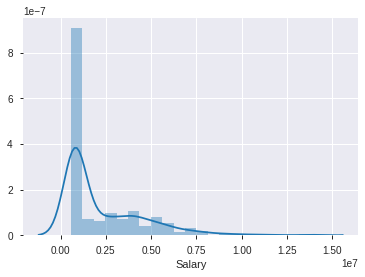

In [332]:
import seaborn as sns
sns.distplot(df[target]);

# Log-Transform

If the target is right-skewed, you may want to "log transform" the target.



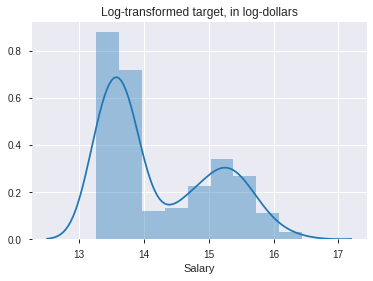

In [333]:
import numpy as np
import matplotlib.pyplot as plt
y_log = np.log1p(df[target])

sns.distplot(y_log)
plt.title('Log-transformed target, in log-dollars');

# Choose your evaluation metric(s)

Regression: Will you use mean absolute error, root mean squared error, R^2, or other regression metrics?

# 1. Begin with baselines for regression

In [334]:
pd.options.display.float_format = '{:,.0f}'.format
df['Salary'].describe()

count          612
mean     2,264,509
std      2,236,340
min        575,000
25%        742,500
50%        925,000
75%      3,500,000
max     13,800,000
Name: Salary, dtype: float64

Avarage salary in NHL per player is $2,3 million . So that could be a reasonable first guess.

In [0]:
guess = df['Salary'].mean()
errors = guess - df['Salary']
mean_absolute_error = errors.abs().mean()

In [336]:
print(f'If we just guessed that every player in NHL earn ${guess:,.0f},')
print(f'we would be off by ${mean_absolute_error:,.0f} on average.')

If we just guessed that every player in NHL earn $2,264,509,
we would be off by $1,775,263 on average.


# 2. Predictive Model

In [337]:
# Make a Plotly Express scatter plot of Goals vs Salary

import plotly.express as px
px.scatter(df, x="Goals", y="Salary"
           , trendline='ols', color='Salary',
           title='Comparasion: Salary vs. Goals'
           
           , template='plotly_dark'
          )

# 3. Follow the 5 step process, and refer to Scikit-Learn LinearRegression documentation.

Linear Regression with one feature

In [338]:
# 1. Import the appropriate estimator class from Scikit-Learn
from sklearn.linear_model import LinearRegression

# 2. Instantiate this class
model = LinearRegression()

# 3. Arrange X features matrix & y target vector
features = ['Goals']
target = 'Salary'
X_train = df[features]
y_train = df[target]

# 4. Fit the model
model.fit(X_train, y_train)


LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [339]:
# 5. Apply the model to new data
goals = 20
X_test = [[goals]]
y_pred = model.predict(X_test)

y_pred

array([3965759.35443263])

# we'll look at the coef_ and intercept_ attributes of the LinearRegression object.

In [340]:
model.coef_

array([138803.53951643])

In [341]:
model.intercept_

1189688.564103952

In [0]:
# Equations for a line
m = model.coef_[0]
b = model.intercept_

In [343]:
print('y = mx + b')
print(f'y = {m:,.0f}*x + {b:,.0f}')
print(f'Salary = {m:,.0f} * Goals + {b:,.0f}')

y = mx + b
y = 138,804*x + 1,189,689
Salary = 138,804 * Goals + 1,189,689


In [344]:
def predict(goals):
    y_pred = model.predict([[goals]])
    estimate = y_pred[0]
    coefficient = model.coef_[0]
    result = f'${estimate:,.0f} estimated salary for {goals:,.0f} goals.' 
    explanation = f'In this linear regression, each additional goal adds ${coefficient:,.0f}.'
    return result + '\n' + explanation

print(predict(20))

$3,965,759 estimated salary for 20 goals.
In this linear regression, each additional goal adds $138,804.


In [345]:
# What does the model predict not to many shooted goals?
print(predict(5))

$1,883,706 estimated salary for 5 goals.
In this linear regression, each additional goal adds $138,804.


# Use scikit-learn to fit a multiple regression

1. **Do** **train/test split** **bold text**

In [346]:
from sklearn.model_selection import train_test_split
train, test = train_test_split(df, random_state=42)
train.shape, test.shape

((459, 98), (153, 98))

In [0]:
df['Born'] = pd.to_datetime(df['Born'], infer_datetime_format=True)


2. **Explore & clean your data**

In [348]:
import pandas_profiling
train.profile_report()

OTG - Overtime Goals has 83% zeros
therefore we will deal with zeros

In [0]:
df = train.head().copy()

In [0]:
df = test.head().copy()

In [0]:
# Treat zeros like null values. 
# Replace in both sets with the mean from the training set.
train['OTG'] = train['OTG'].replace(0, train['OTG'].mean())
test['OTG'] = test['OTG'].replace(0, train['OTG'].mean())

In [352]:
# Split train into train & val
train, val = train_test_split(train,
                              random_state=42)

train.shape, val.shape, test.shape

((344, 98), (115, 98), (153, 98))

# Permutation and Boosting

In [0]:
# Permutation and Boosting

In [0]:
# Arrange data into X features matrix and y target vector
target = 'Salary'
X_train = train.drop(columns=target)
y_train = train[target]
X_val = val.drop(columns=target)
y_val = val[target]
X_test = test

In [354]:
import category_encoders as ce
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline

pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='median'), 
    RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
)

# Fit on train, score on val
pipeline.fit(X_train, y_train)
print('Score', pipeline.score(X_val, y_val))

Score 0.5001127454670116


# 1. (Default) Feature Importances

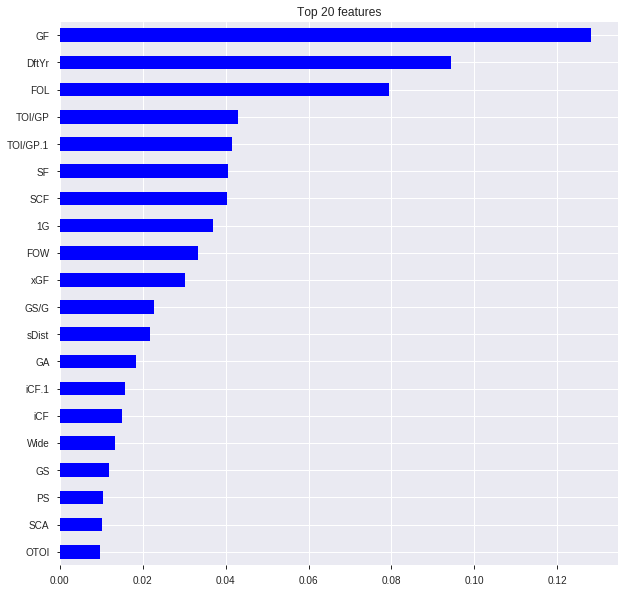

In [355]:
# Get feature importances
rf = pipeline.named_steps['randomforestregressor']
importances = pd.Series(rf.feature_importances_, X_train.columns)

# Plot feature importances
%matplotlib inline
import matplotlib.pyplot as plt

n = 20
plt.figure(figsize=(10,n/2))
plt.title(f'Top {n} features')
importances.sort_values()[-n:].plot.barh(color='blue');

# 2. Drop-Column Importance

In [356]:
column  = 'Points'

# Fit without column
pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='median'), 
    RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
)
pipeline.fit(X_train.drop(columns=column), y_train)
score_without = pipeline.score(X_val.drop(columns=column), y_val)
print(f'Score without {column}: {score_without}')

# Fit with column
pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='median'), 
    RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
)
pipeline.fit(X_train, y_train)
score_with = pipeline.score(X_val, y_val)
print(f'Score with {column}: {score_with}')

# Compare the error with & without column
print(f'Drop-Column Importance for {column}: {score_with - score_without}')

Score without Points: 0.4946851891479276
Score with Points: 0.5001127454670116
Drop-Column Importance for Points: 0.0054275563190839815


# 3. Permutation Importance

In [357]:
# BEFORE: Sequence of the feature to be permuted
feature = 'Points'
X_val[feature].head()

319    53
412    13
150    65
191    42
515    20
Name: Points, dtype: int64

In [358]:
# BEFORE: Distribution of the feature to be permuted
X_val[feature].value_counts()

0     13
1      5
24     5
28     5
25     5
8      4
7      3
35     3
13     3
10     3
12     3
26     3
2      3
6      3
3      3
61     3
17     2
23     2
31     2
20     2
4      2
53     2
55     2
44     2
19     1
15     1
14     1
21     1
5      1
11     1
9      1
16     1
86     1
27     1
48     1
69     1
66     1
65     1
64     1
62     1
59     1
52     1
50     1
49     1
47     1
85     1
45     1
43     1
42     1
41     1
38     1
37     1
36     1
34     1
32     1
30     1
Name: Points, dtype: int64

In [0]:
# PERMUTE!
X_val_permuted = X_val.copy()
X_val_permuted[feature] = np.random.permutation(X_val[feature])

In [360]:
# AFTER: Sequence has changed
X_val_permuted[feature].head()

319    44
412     0
150    17
191    26
515    52
Name: Points, dtype: int64

In [361]:
# AFTER: Distribution hasn't changed!
X_val_permuted[feature].value_counts()

0     13
1      5
24     5
28     5
25     5
8      4
7      3
35     3
13     3
10     3
12     3
26     3
2      3
6      3
3      3
61     3
17     2
23     2
31     2
20     2
4      2
53     2
55     2
44     2
19     1
15     1
14     1
21     1
5      1
11     1
9      1
16     1
86     1
27     1
48     1
69     1
66     1
65     1
64     1
62     1
59     1
52     1
50     1
49     1
47     1
85     1
45     1
43     1
42     1
41     1
38     1
37     1
36     1
34     1
32     1
30     1
Name: Points, dtype: int64

In [362]:
# Get the permutation importance
# Notice that we don't need to refit here!
score_permuted = pipeline.score(X_val_permuted, y_val)

print(f'Score with {feature}: {score_with}')
print(f'Score with {feature} permuted: {score_permuted}')
print(f'Permutation importance: {score_with - score_permuted}')

Score with Points: 0.5001127454670116
Score with Points permuted: 0.49776557322086246
Permutation importance: 0.0023471722461491096


In [363]:
# Rerun the permutation importance process, but for a different feature
feature = 'Goals'
X_val_permuted = X_val.copy()
X_val_permuted[feature] = np.random.permutation(X_val[feature])
score_permuted = pipeline.score(X_val_permuted, y_val)

print(f'Score with {feature}: {score_with}')
print(f'Score with {feature} permuted: {score_permuted}')
print(f'Permutation importance: {score_with - score_permuted}')

Score with Goals: 0.5001127454670116
Score with Goals permuted: 0.49701146612432057
Permutation importance: 0.003101279342690999


# With eli5 library

In [0]:
transformers = make_pipeline(
    ce.OrdinalEncoder(), 
    SimpleImputer(strategy='median')
)

In [365]:
X_train_transformed = transformers.fit_transform(X_train)
X_val_transformed = transformers.transform(X_val)

model = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
model.fit(X_train_transformed, y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
                      oob_score=False, random_state=42, verbose=0,
                      warm_start=False)

In [305]:
!pip install eli5
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()
import eli5
from eli5.sklearn import PermutationImportance





# Use xgboost for gradient boosting

In [366]:
from xgboost import XGBRegressor

pipeline = make_pipeline(
    ce.OrdinalEncoder(), 
    XGBRegressor(n_estimators=100, random_state=42, n_jobs=-1)
)

pipeline.fit(X_train, y_train)

Series.base is deprecated and will be removed in a future version
Series.base is deprecated and will be removed in a future version


[18:46:29] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


Pipeline(memory=None,
         steps=[('ordinalencoder',
                 OrdinalEncoder(cols=['Born', 'Nationality', 'Hand',
                                      'Last_name', 'Position', 'Team'],
                                drop_invariant=False, handle_missing='value',
                                handle_unknown='value',
                                mapping=[{'col': 'Born',
                                          'data_type': dtype('O'),
                                          'mapping': 91-11-01      1
93-07-12      2
89-07-05      3
97-05-26      4
92-04-20      5
           ... 
95-02-09    330
94-05-25    331
92-11-24    332
88-04-20    333
NaN          -2
Leng...
                              colsample_bylevel=1, colsample_bynode=1,
                              colsample_bytree=1, gamma=0,
                              importance_type='gain', learning_rate=0.1,
                              max_delta_step=0, max_depth=3, min_child_weight=1,
                       

# shapley value plots

In [0]:
# Arrange X features matrix & y target vector
features = ['Goals', 'Points']
target = 'Salary'
X = df[features]
y = df[target]

# Fit model
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X, y)

def predict(bedrooms, bathrooms):
    y_pred = model.predict([[bedrooms, bathrooms]])
    estimate = y_pred[0]
    bed_coef = model.coef_[0]
    bath_coef = model.coef_[1]
    
    # Format with $ and comma separators. No decimals.
    result = f'Rent for a {bedrooms}-bed, {bathrooms}-bath apartment in NYC is estimated at ${estimate:,.0f}.'
    explanation = f' In this model, each bedroom adds ${bed_coef:,.0f} & each bathroom adds ${bath_coef:,.0f}.'
    return result + explanation

In [0]:
# Assign to X, y
features = ['Goals', 'Points', 'SCA', 'OTOI']
target = 'Salary'
X_train = train[features]
y_train = train[target]
X_test = test[features]
y_test = test[target]

In [369]:
from scipy.stats import randint, uniform
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV

param_distributions = { 
    'n_estimators': randint(50, 500), 
    'max_depth': [5, 10, 15, 20, None], 
    'max_features': uniform(0, 1), 
}

search = RandomizedSearchCV(
    RandomForestRegressor(random_state=42), 
    param_distributions=param_distributions, 
    n_iter=5, 
    cv=2, 
    scoring='neg_mean_absolute_error', 
    verbose=10, 
    return_train_score=True, 
    n_jobs=-1, 
    random_state=42
)

search.fit(X_train, y_train);

Fitting 2 folds for each of 5 candidates, totalling 10 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:    4.0s finished


In [370]:
print('Best hyperparameters', search.best_params_)
print('Cross-validation MAE', -search.best_score_)
model = search.best_estimator_

Best hyperparameters {'max_depth': 15, 'max_features': 0.09997491581800289, 'n_estimators': 137}
Cross-validation MAE 1100645.5450480354


In [0]:
row = X_test.iloc[[0]]

In [374]:
y_test.iloc[[0]]

81    3400000
Name: Salary, dtype: int64

In [375]:
model.predict(row)

array([4189343.06569343])

In [314]:
import sklearn
import shap


explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(row)

shap.initjs()
shap.force_plot(
    base_value=explainer.expected_value, 
    shap_values=shap_values,
    features=row
)

Setting feature_perturbation = "tree_path_dependent" because no background data was given.


In [376]:
# Base value is approximately equal to the mean baseline
explainer.expected_value, y_train.mean()

(2257228.5690035652, 2231812.863372093)

In [377]:
feature_names = row.columns
feature_values = row.values[0]
shaps = pd.Series(shap_values[0], zip(feature_names, feature_values))
shaps

(Goals, 19.0)       308,101
(Points, 59.0)    1,383,528
(SCA, 190.0)        336,133
(OTOI, 3234.73)     -95,647
dtype: float64

In [378]:
shaps.sum()

1932114.496689888

In [379]:
explainer.expected_value + shaps.sum()

4189343.065693453

# Define the predict function

In [380]:
def predict(bedrooms, bathrooms, longitude, latitude):

    # Make dataframe from the inputs
    df = pd.DataFrame(
        data=[[bedrooms, bathrooms, longitude, latitude]], 
        columns=['Goals', 'Points', 'SCA', 'OTOI']
    )

    # Get the model's prediction
    pred = model.predict(df)[0]

    # Calculate shap values
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(df)

    # Get series with shap values, feature names, & feature values
    feature_names = df.columns
    feature_values = df.values[0]
    shaps = pd.Series(shap_values[0], zip(feature_names, feature_values))

    # Print results
    result = f'${pred:,.0f} estimated rent for this NYC apartment. \n\n'
    result += f'Starting from baseline of ${explainer.expected_value:,.0f} \n'
    result += shaps.to_string()
    print(result)


    # Show shapley values force plot
    shap.initjs()
    return shap.force_plot(
        base_value=explainer.expected_value, 
        shap_values=shap_values, 
        features=df
    )

predict(19, 59, 190, 3234.73)

$4,189,343 estimated rent for this NYC apartment. 

Starting from baseline of $2,257,229 
(Goals, 19.0)       308,101
(Points, 59.0)    1,383,528
(SCA, 190.0)        336,133
(OTOI, 3234.73)     -95,647


Setting feature_perturbation = "tree_path_dependent" because no background data was given.


In [381]:
predict(25, 59, 190, 3234.73)

$3,586,302 estimated rent for this NYC apartment. 

Starting from baseline of $2,257,229 
(Goals, 25.0)       311,470
(Points, 59.0)    1,054,297
(SCA, 190.0)        249,671
(OTOI, 3234.73)    -286,365


Setting feature_perturbation = "tree_path_dependent" because no background data was given.


# Partial Dependence Plots with 2 features

In [0]:
# Assign to X, y
target = 'Salary'
features = ['Born', 'Nationality', 'DftYr', 'Hand', 'Last_name',
       'Position', 'Team', 'Games_played', 'Goals',
       'Events_against_per_60_minutes', 'Primary_assists', 'Secondary_Assists',
       'Points', 'Time_on_ice', 'TOIX', 'TOI/GP', 'TOI/GP.1', 'TOI%',
       'Indiv_points', 'SH%', 'SV%', 'PDO', 'F/60', 'A/60', 'Pct%', 'Diff',
       'Diff/60', 'iCF', 'iCF.1', 'iFF', 'iSF', 'iSF.1', 'iSF.2', 'ixG',
       'iSCF', 'iRB', 'iRS', 'iDS', 'sDist', 'sDist.1', 'Pass', 'iHF', 'iHA',
       'iHDf', 'iMiss', 'iGVA', 'iTKA', 'iBLK', 'iFOW', 'iFOL', 'FO%', '%FOT',
       'ozFOW', 'ozFOL', 'FOW.Up', 'FOL.Up', 'OTG', '1G', 'GWG', 'ENG', 'PSG',
       'PSA', 'CBar_', 'Post', 'Over', 'Wide', 'CF', 'CA', 'SF', 'SA', 'xGF',
       'xGA', 'SCF', 'SCA', 'GF', 'GA', 'RBF', 'RBA', 'DSF', 'DSA', 'FOW',
       'FOL', 'HF', 'HA', 'GVA', 'TKA', 'PENT', 'PEND', 'OPS', 'DPS', 'PS',
       'OTOI', 'Grit', 'DAP', 'Pace', 'GS', 'GS/G']

X_train = train[features]
y_train = train[target]

X_val = val[features]
y_val = val[target]

X_test = test[features]
y_test = test[target]

In [390]:
import category_encoders as ce
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

lr = make_pipeline(
    ce.TargetEncoder(),  
    LinearRegression()
)

lr.fit(X_train, y_train)
print('Linear Regression R^2', lr.score(X_val, y_val))

Linear Regression R^2 -0.26503048692122794


In [391]:
coefficients = lr.named_steps['linearregression'].coef_
pd.Series(coefficients, features)

Born                1
Nationality        -0
DftYr             261
Hand               -1
Last_name           1
                ...  
Grit            9,485
DAP           -10,892
Pace          -15,015
GS            -10,911
GS/G          654,959
Length: 97, dtype: float64

In [0]:
from sklearn.metrics import r2_score
from xgboost import XGBRegressor

In [393]:
gb = make_pipeline(
    ce.OrdinalEncoder(), 
    XGBRegressor(n_estimators=200, objective='reg:squarederror', n_jobs=-1)
)

gb.fit(X_train, y_train)
y_pred = gb.predict(X_val)
print('Gradient Boosting R^2', r2_score(y_val, y_pred))

Gradient Boosting R^2 0.5069172192340672


In [0]:
from pdpbox.pdp import pdp_interact, pdp_interact_plot
from pdpbox.pdp import pdp_isolate, pdp_plot
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 72

In [0]:
feature = 'OTOI'

isolated = pdp_isolate(
    model=gb, 
    dataset=X_val, 
    model_features=X_val.columns, 
    feature=feature
)

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


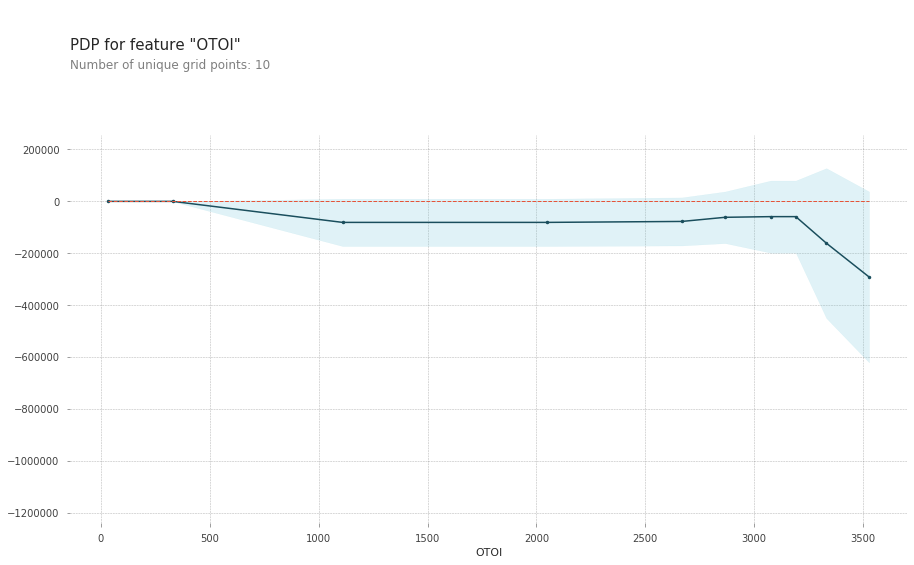

In [398]:
pdp_plot(isolated, feature_name=feature);

In [401]:
isolated = pdp_isolate(
    model=gb, 
    dataset=X_val, 
    model_features=X_val.columns, 
    feature=feature, 
    num_grid_points=50
)

# How many predictions are required to make a PDP with 1 feature,
# given the size of our dataset, and the number of grid points?
len(X_val) * 50

5750

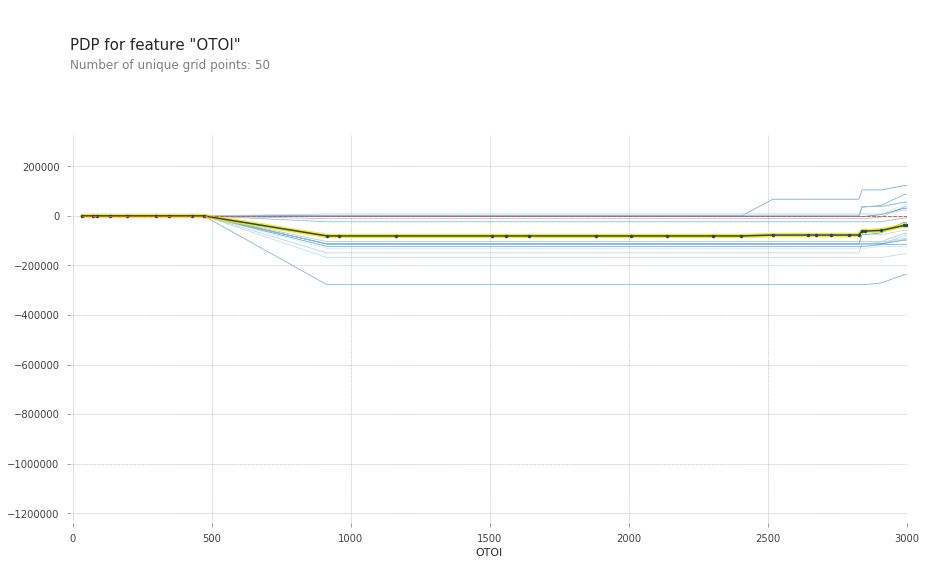

In [413]:
pdp_plot(isolated, feature_name=feature, plot_lines=True, 
         frac_to_plot=0.2)

plt.xlim(-10,3000);

# Partial Dependence Plots with 2 features

In [0]:
from pdpbox.pdp import pdp_interact, pdp_interact_plot

In [0]:
features = ['SCA', 'OTOI']

interaction = pdp_interact(
    model=gb, 
    dataset=X_val,
    model_features=X_val.columns, 
    features=features
)

findfont: Font family ['Arial'] not found. Falling back to DejaVu Sans.


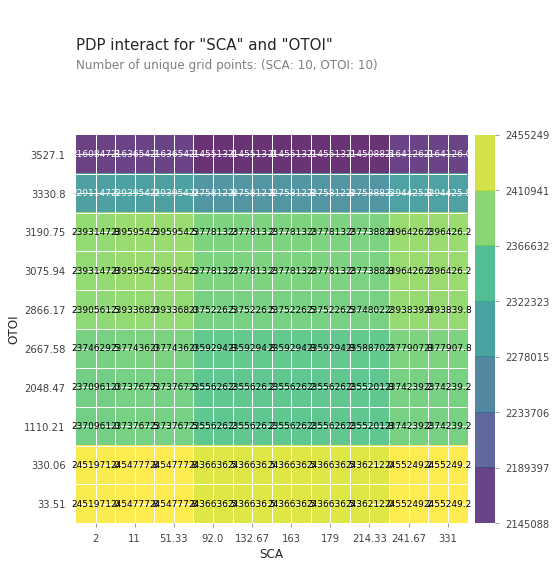

In [416]:
pdp_interact_plot(interaction, plot_type='grid', 
                  feature_names=features);

# 3D with Plotly!

In [0]:
# First, make the 2D plot above. Then ...

pdp = interaction.pdp.pivot_table(
    values='preds', 
    columns=features[0], 
    index=features[1]
)[::-1] # Slice notation to reverse index order so y axis is ascending

In [420]:
pdp = pdp.drop(columns=[11, 331])

pdp

SCA,2,51,92,133,163,179,214,242
OTOI,,,,,,,,
"3,527","2,160,848","2,163,654","2,145,513","2,145,513","2,145,513","2,145,513","2,145,088","2,164,126"
"3,331","2,291,148","2,293,954","2,275,813","2,275,813","2,275,813","2,275,813","2,275,388","2,294,426"
"3,191","2,393,148","2,395,954","2,377,813","2,377,813","2,377,813","2,377,813","2,377,389","2,396,426"
"3,076","2,393,148","2,395,954","2,377,813","2,377,813","2,377,813","2,377,813","2,377,389","2,396,426"
"2,866","2,390,562","2,393,368","2,375,227","2,375,227","2,375,227","2,375,227","2,374,802","2,393,840"
"2,668","2,374,630","2,377,436","2,359,295","2,359,295","2,359,295","2,359,295","2,358,870","2,377,908"
"2,048","2,370,961","2,373,768","2,355,626","2,355,626","2,355,626","2,355,626","2,355,202","2,374,239"
"1,110","2,370,961","2,373,768","2,355,626","2,355,626","2,355,626","2,355,626","2,355,202","2,374,239"
330,"2,451,971","2,454,778","2,436,636","2,436,636","2,436,636","2,436,636","2,436,212","2,455,249"


In [421]:
import plotly.graph_objs as go

surface = go.Surface(
    x=pdp.columns, 
    y=pdp.index, 
    z=pdp.values
)


layout = go.Layout(
    scene=dict(
        xaxis=dict(title=features[0]), 
        yaxis=dict(title=features[1]), 
        zaxis=dict(title=target)
    )
)

fig = go.Figure(surface, layout)
fig.show()